In [1]:
import skimage
print('skimage', skimage.__version__)

skimage 0.18.3


In [37]:
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 600
%matplotlib inline

In [38]:
from skimage import io
original_map = io.imread('original.png',as_gray=True)

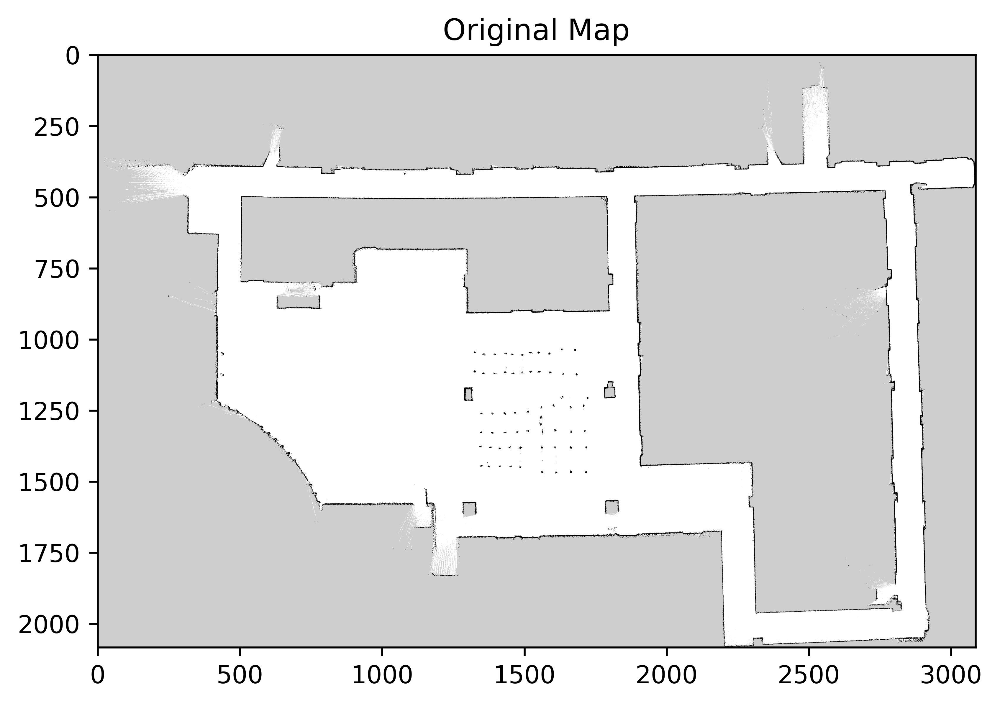

In [39]:
plt.title("Original Map")
plt.imshow(original_map,cmap='gray')

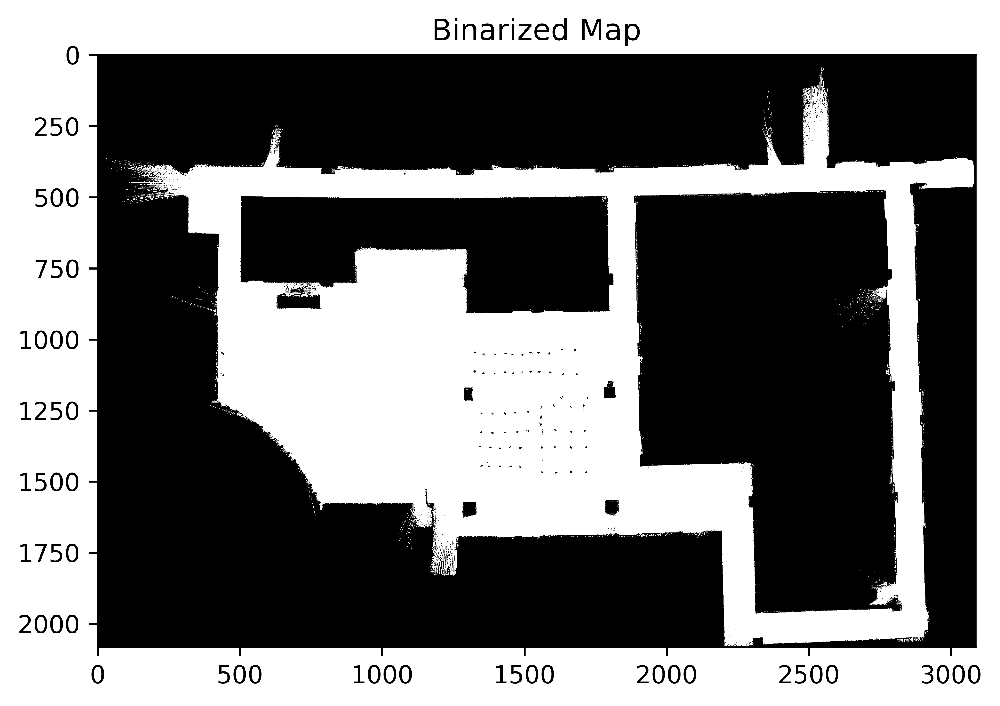

In [48]:
from skimage.filters import threshold_otsu, threshold_local, gaussian
from skimage import color
from skimage.util import invert
# Increase threshold in order to add more
# details to the binarized image
threshold_adjustment = 1
thresh = threshold_otsu(original_map) + threshold_adjustment
binary_map = map_image < thresh

# plt.subplot(144)
plt.title("Binarized Map")
plt.imshow(invert(binary_map), cmap='gray');

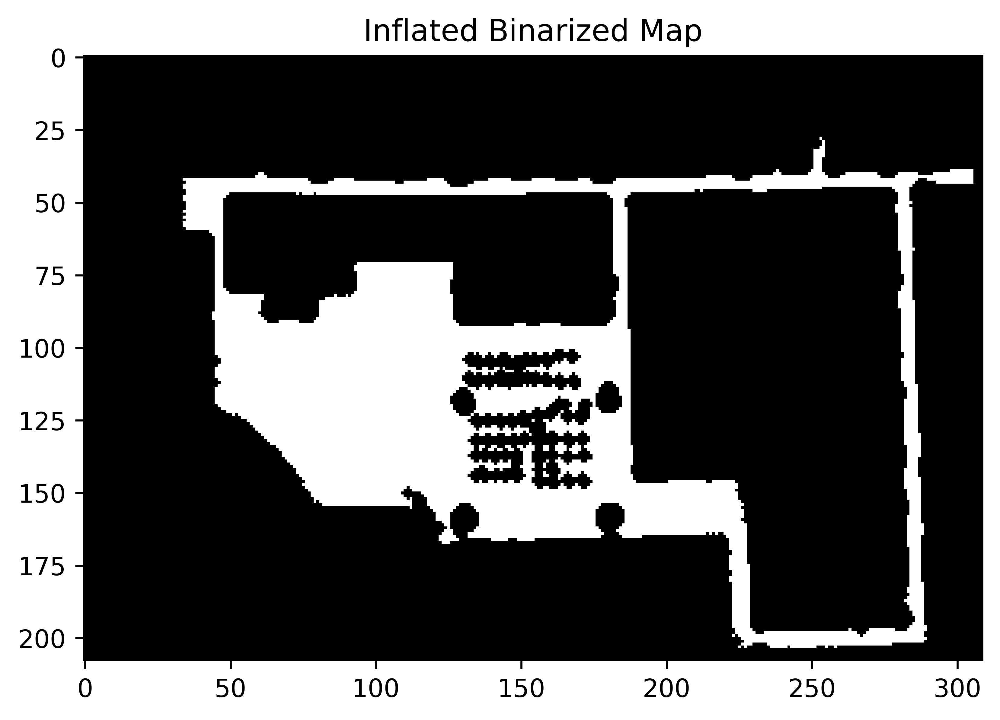

In [77]:
import scipy.ndimage.morphology as morph
import math
import copy
from skimage.transform import rescale
inflated_binary_map = copy.deepcopy(binary_map)

rr= 0.5 #robot radius
resolution = 0.02 #map resolution

step = rr/resolution
# print("step: ", step)
step = math.ceil(step)

for i in range(step):
    inflated_binary_map = morph.binary_dilation(inflated_binary_map)
    
downscaled_inflated_binary_map = rescale(inflated_binary_map,0.1,anti_aliasing=False)
    
plt.title("Inflated Binarized Map")
plt.imshow(invert(downscaled_inflated_binary_map), cmap='gray');

Number of data points: 12,195


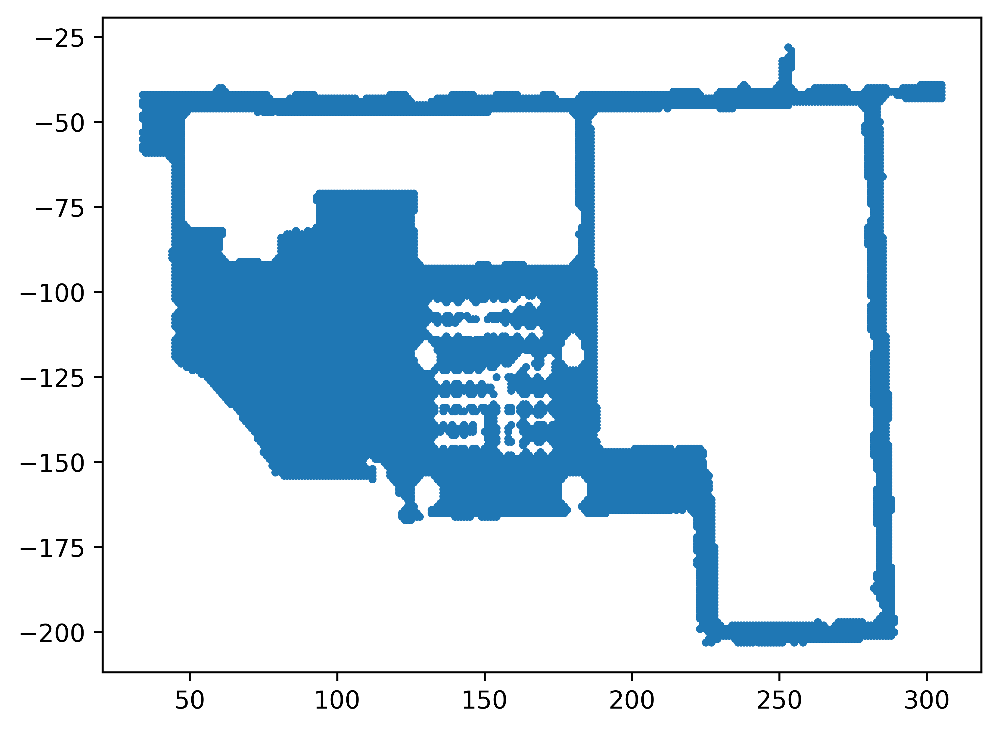

In [93]:
import numpy as np

def image_to_data(img):
    data = []
    for (x, y), value in np.ndenumerate(img):
        if value == 0:
            data.append([y, -x])
    return data

# Convert each black pixel to a separate data point
# We will use these data points in order to learn
# topological structure of the image
data = image_to_data(downscaled_inflated_binary_map)

# Scaling factor allows us to reduce distance between data points
scale_factor = 0.001   
data = scale_factor * np.array(data)
print("Number of data points: {:,}".format(len(data)))

plt.figure()
plt.scatter(*np.array(data).T / scale_factor, s=5, alpha=1);
# plt.show()

(-125.0, -100.0)

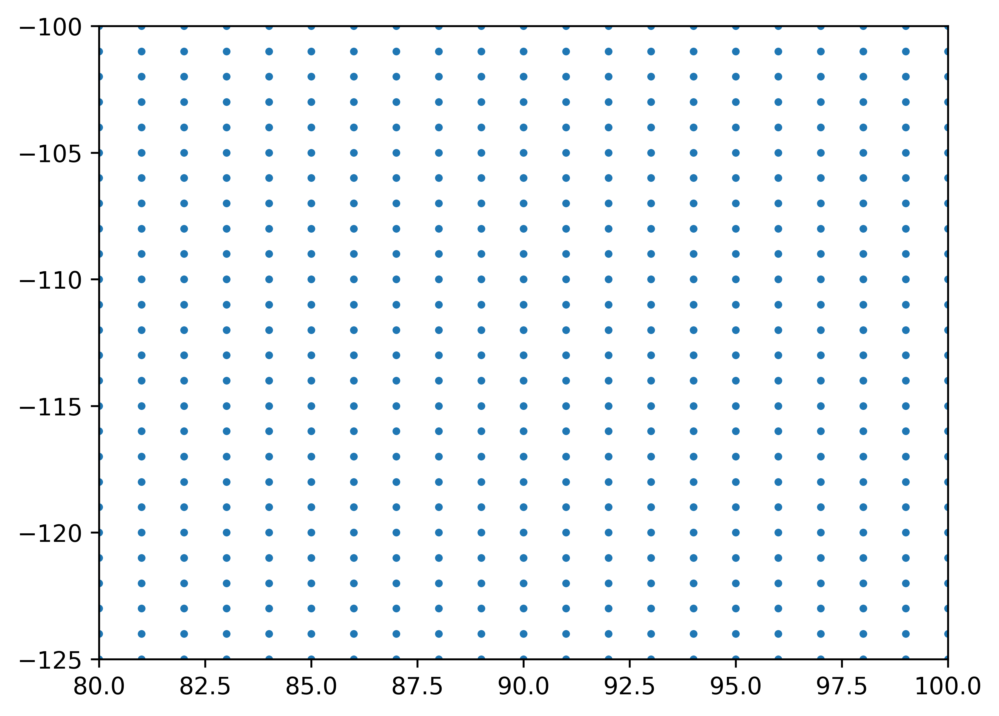

In [81]:
plt.scatter(*np.array(data).T / scale_factor, s=5, alpha=1);
plt.xlim(80, 100)
plt.ylim(-125, -100)

In [82]:
def draw_image(graph, show=True):
    for node_1, node_2 in graph.edges:
        weights = np.concatenate([node_1.weight, node_2.weight])
        line, = plt.plot(*weights.T, color='black')
        plt.setp(line, linewidth=0.2, color='black')

    plt.xticks([], [])
    plt.yticks([], [])
    
    if show:
        plt.show()

In [83]:
def create_gng(max_nodes, step=0.2, n_start_nodes=2, max_edge_age=50):
    return algorithms.GrowingNeuralGas(
        n_inputs=2,
        n_start_nodes=n_start_nodes,

        shuffle_data=True,
        verbose=True,

        step=step,
        neighbour_step=0.005,

        max_edge_age=max_edge_age,
        max_nodes=max_nodes,

        n_iter_before_neuron_added=100,
        after_split_error_decay_rate=0.5,
        error_decay_rate=0.995,
        min_distance_for_update=0.01,
    )


Main information

[ALGORITHM] GrowingNeuralGas

[OPTION] verbose = True
[OPTION] epoch_end_signal = None
[OPTION] show_epoch = 1
[OPTION] shuffle_data = True
[OPTION] train_end_signal = None
[OPTION] after_split_error_decay_rate = 0.5
[OPTION] error_decay_rate = 0.995
[OPTION] max_edge_age = 50
[OPTION] max_nodes = 1500
[OPTION] min_distance_for_update = 0.01
[OPTION] n_inputs = 2
[OPTION] n_iter_before_neuron_added = 100
[OPTION] n_start_nodes = 2
[OPTION] neighbour_step = 0.005
[OPTION] step = 0.2


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|           1 |   0.0095869 |           - |      884 ms |
---------------------------------------------------------



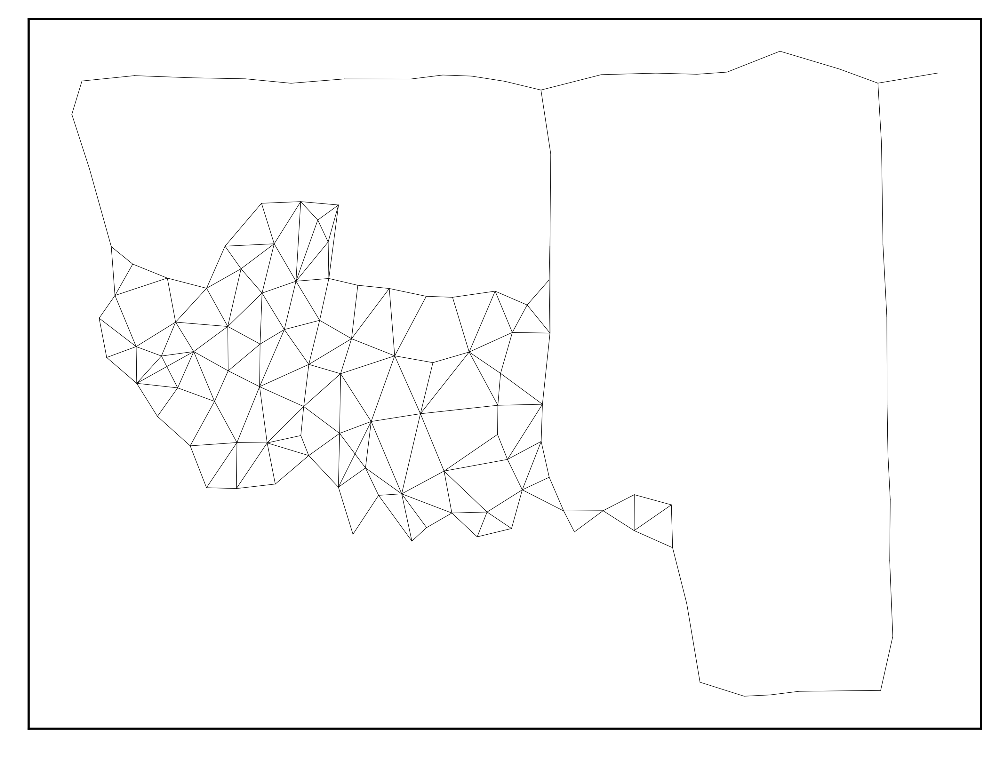


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|           2 |   0.0036363 |           - |       1 sec |
---------------------------------------------------------



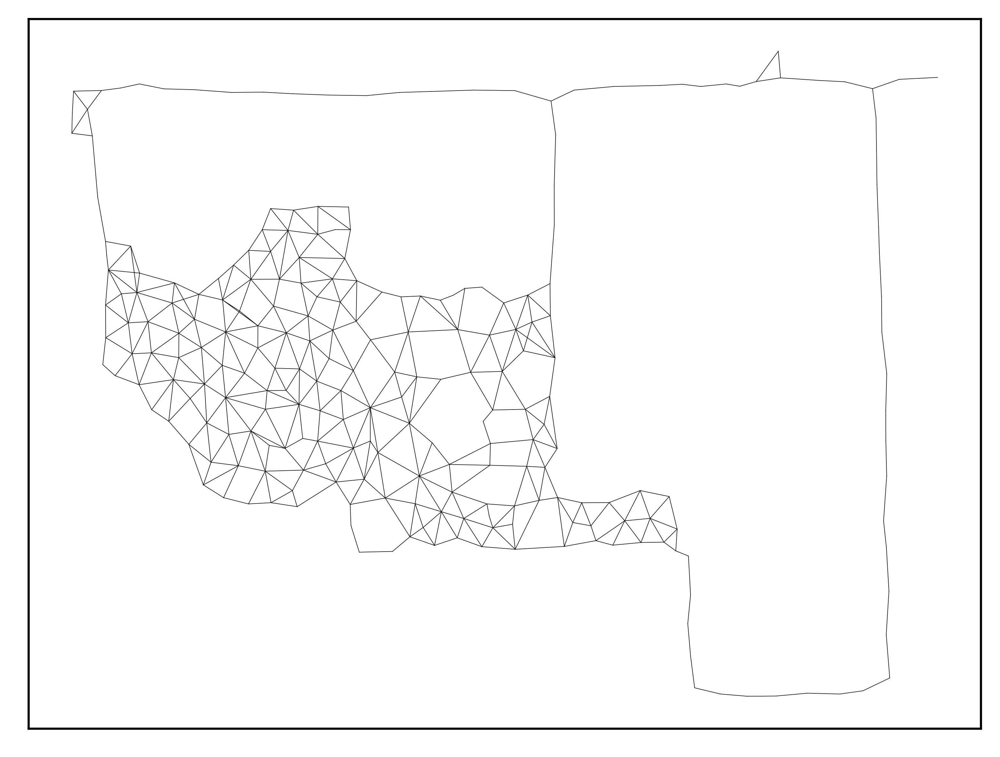


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|           3 |   0.0027163 |           - |       2 sec |
---------------------------------------------------------



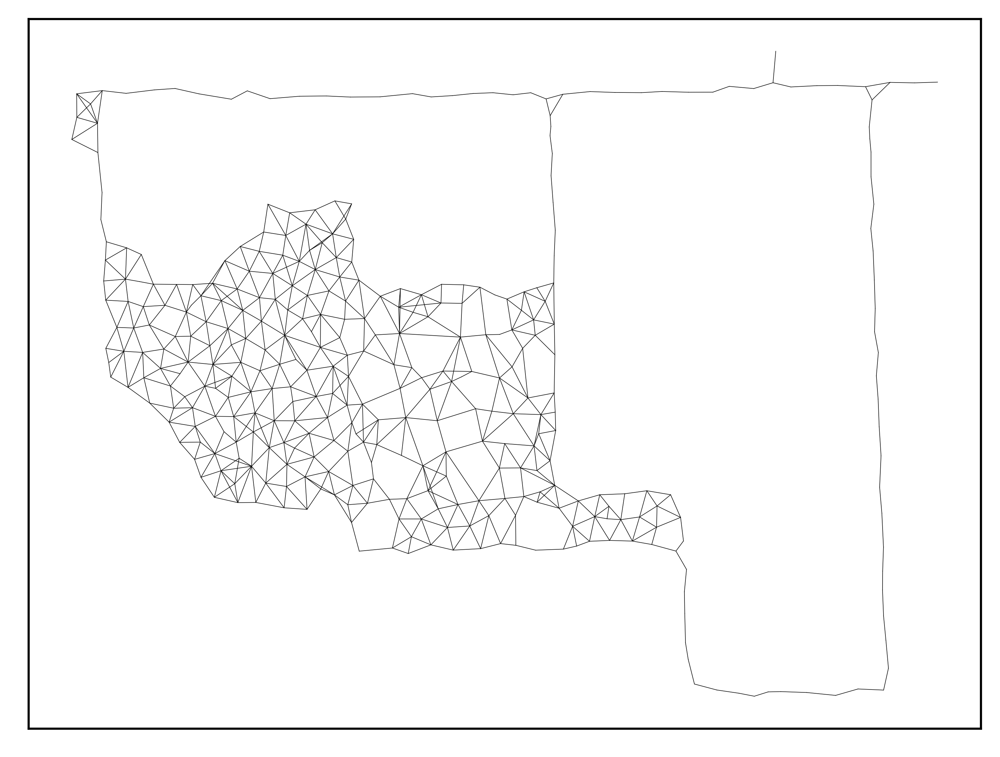


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|           4 |   0.0022805 |           - |       3 sec |
---------------------------------------------------------



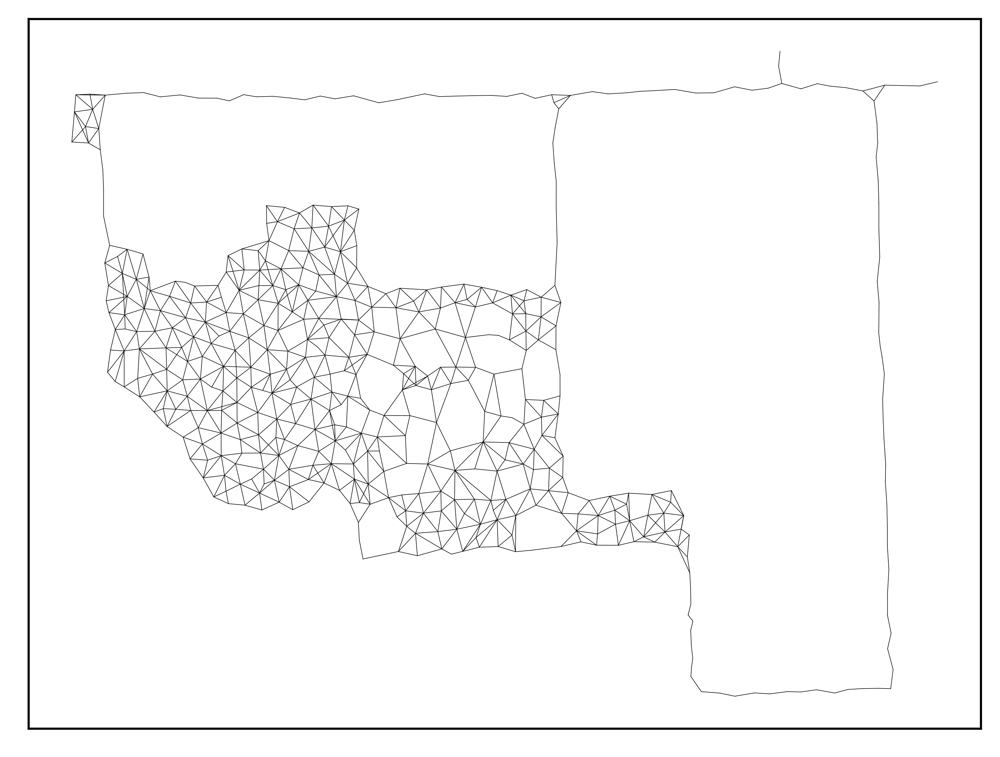


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|           5 |   0.0020036 |           - |       3 sec |
---------------------------------------------------------



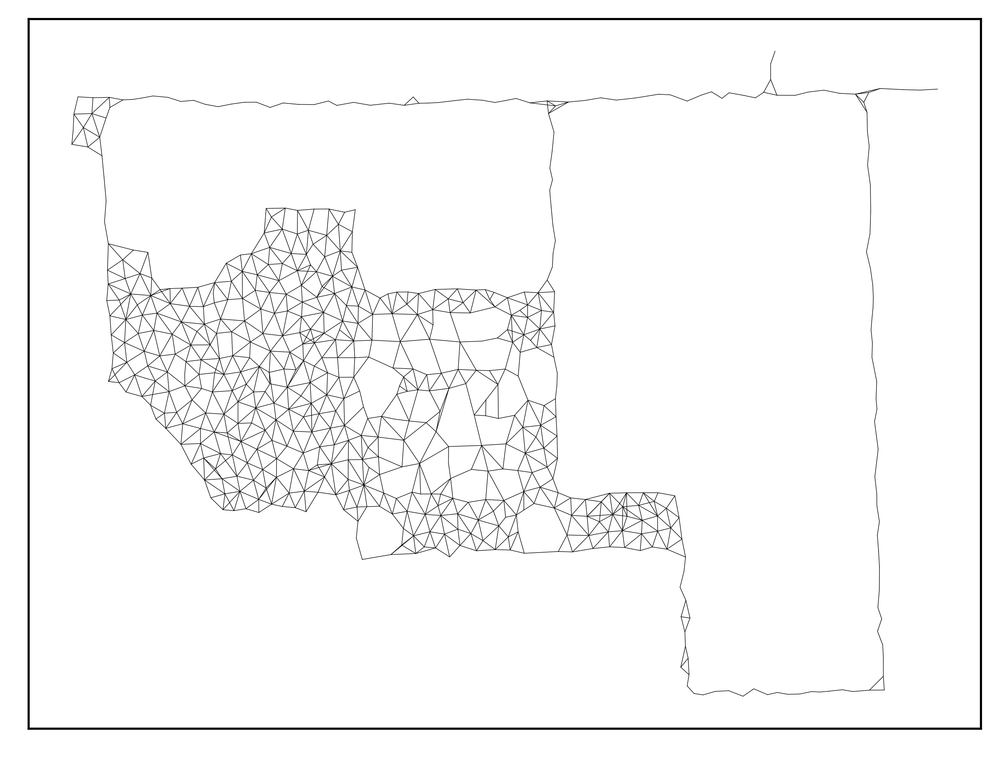


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|           6 |   0.0018229 |           - |       4 sec |
---------------------------------------------------------



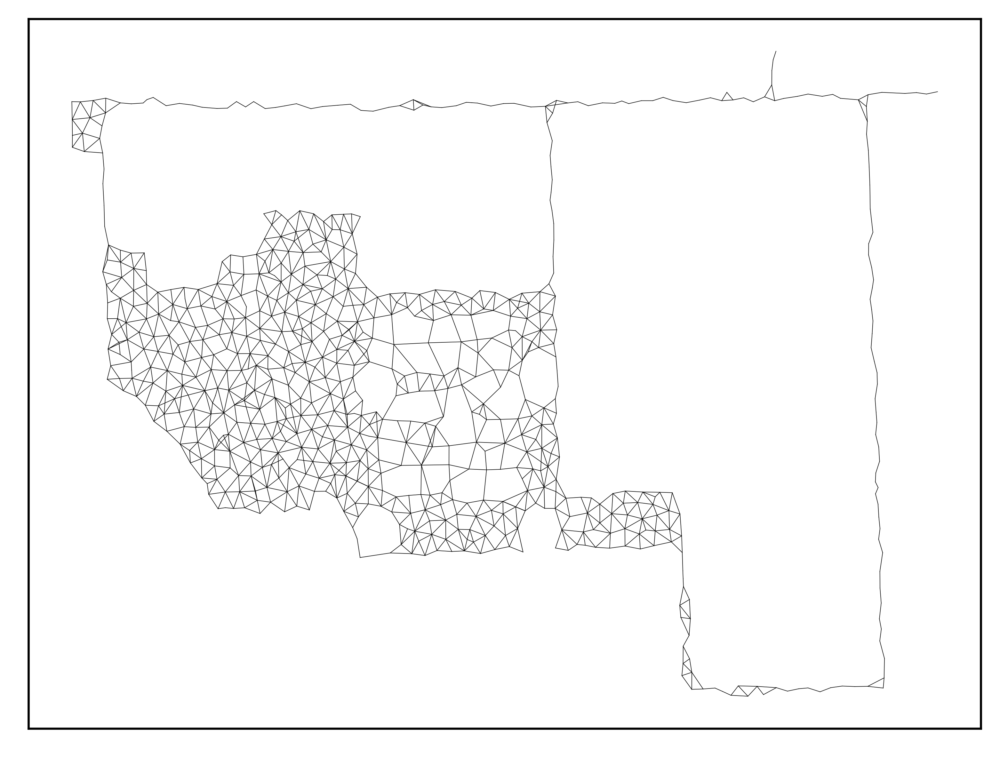


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|           7 |   0.0016856 |           - |       5 sec |
---------------------------------------------------------



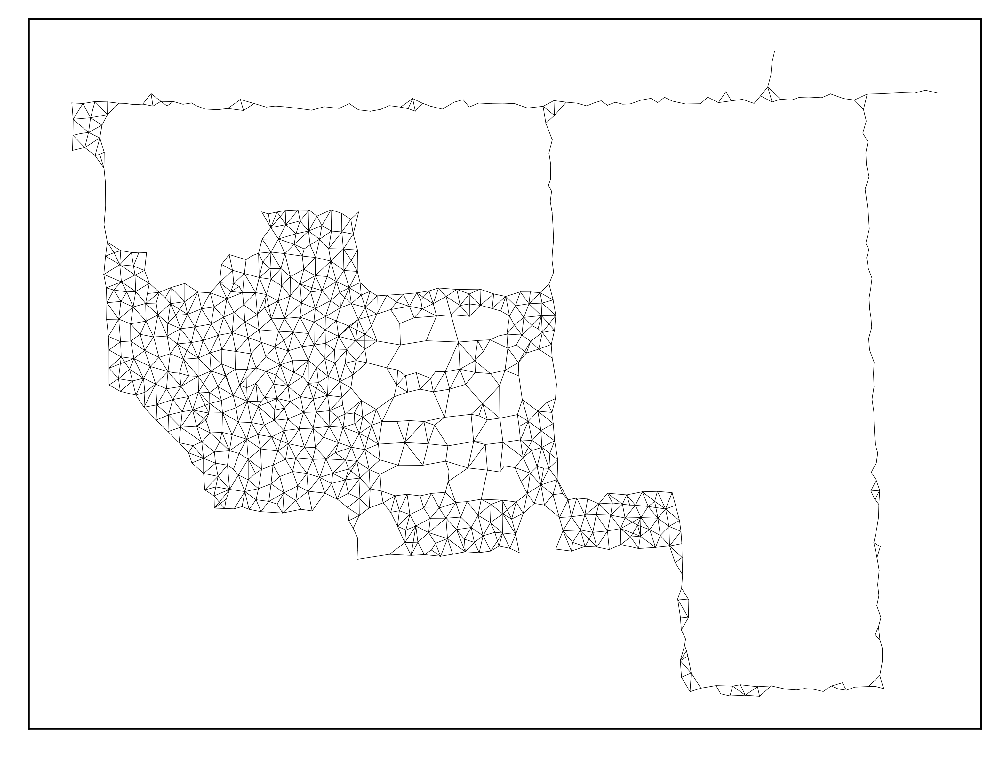


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|           8 |   0.0015732 |           - |       6 sec |
---------------------------------------------------------



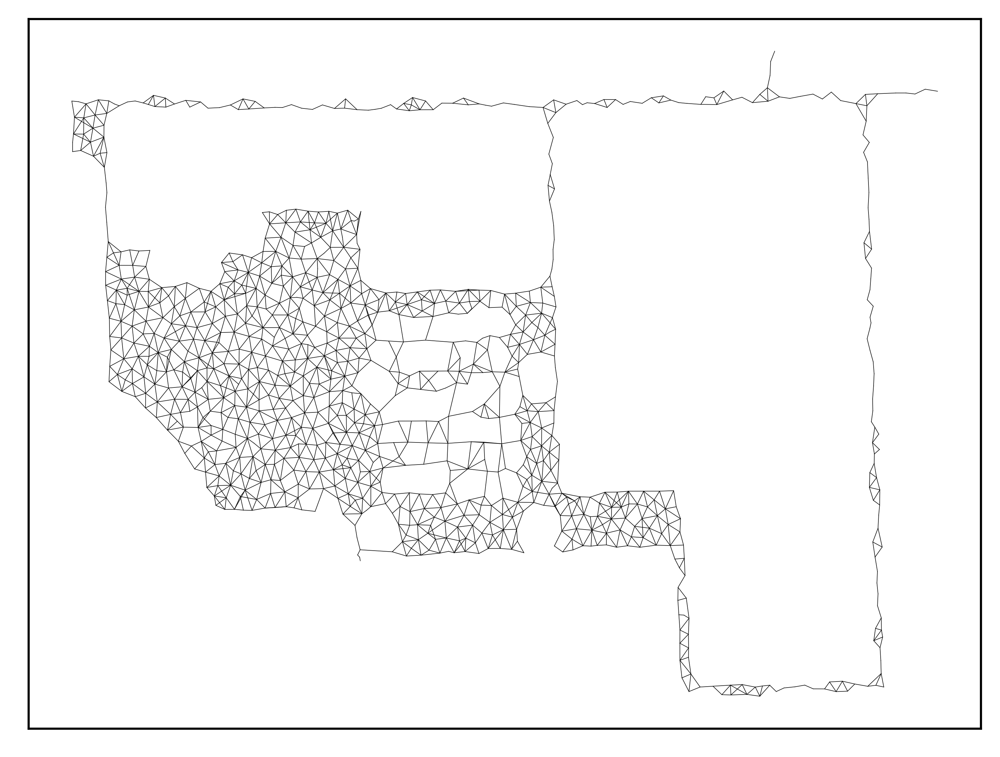


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|           9 |   0.0014723 |           - |       7 sec |
---------------------------------------------------------



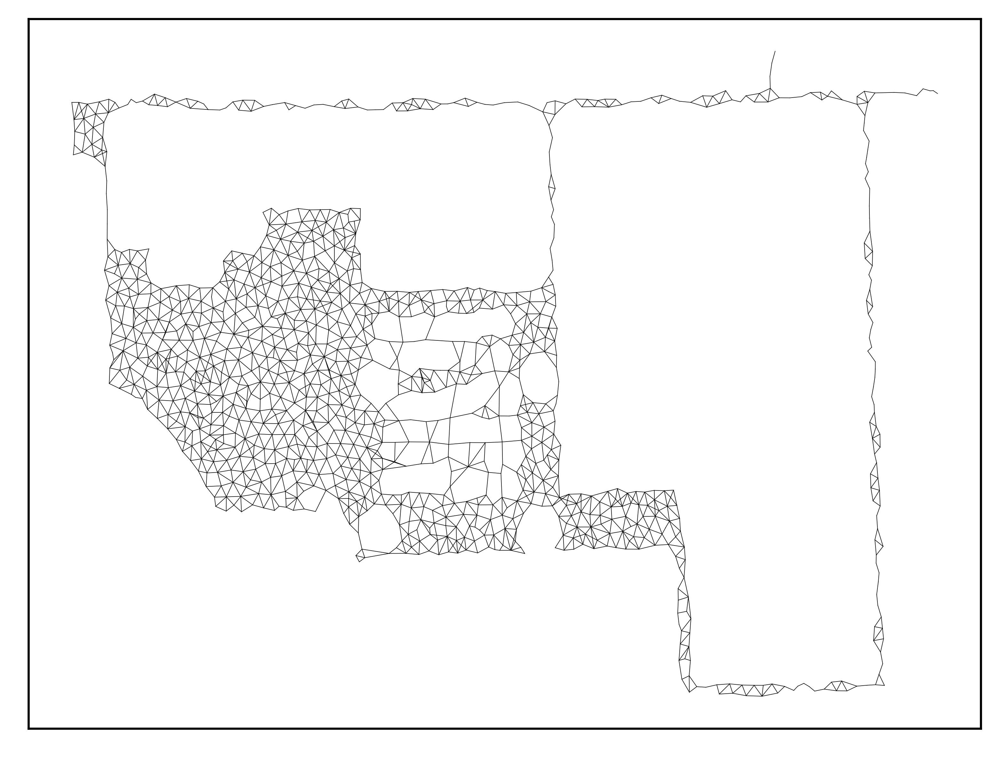


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|          10 |   0.0013933 |           - |       7 sec |
---------------------------------------------------------



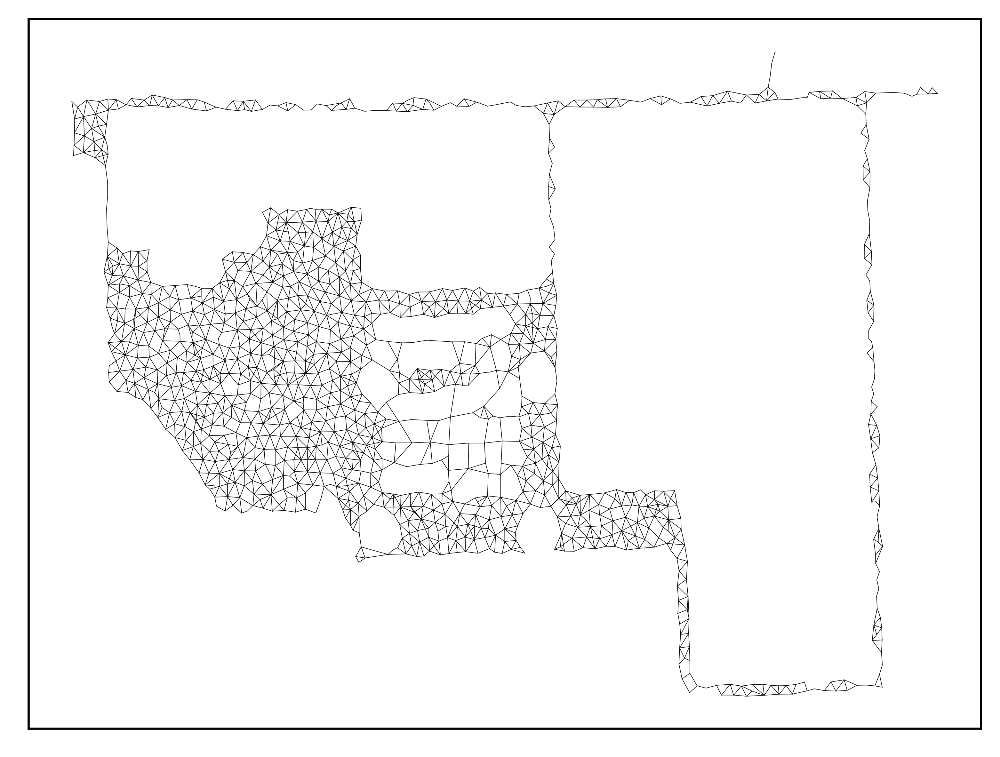


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|          11 |   0.0013229 |           - |       8 sec |
---------------------------------------------------------



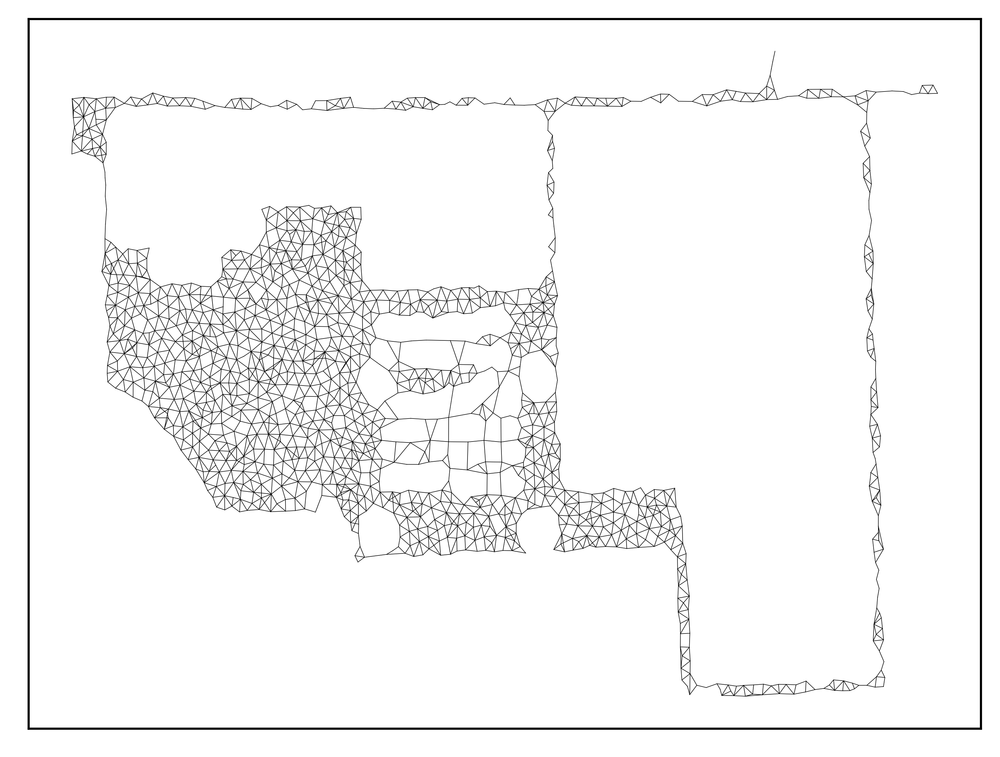


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|          12 |    0.001262 |           - |       9 sec |
---------------------------------------------------------



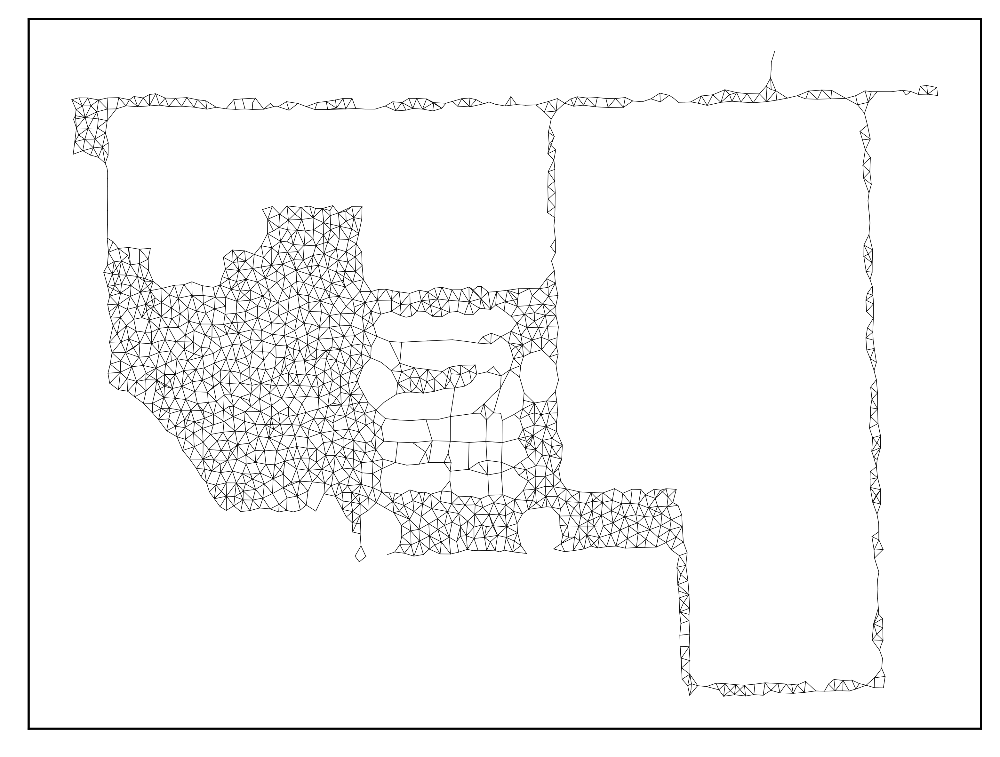


Start training

[TRAINING DATA] shapes: (12195, 2)
[TRAINING] Total epochs: 1

---------------------------------------------------------
|    Epoch    |  Train err  |  Valid err  |    Time     |
---------------------------------------------------------
|          13 |   0.0012142 |           - |      10 sec |
---------------------------------------------------------



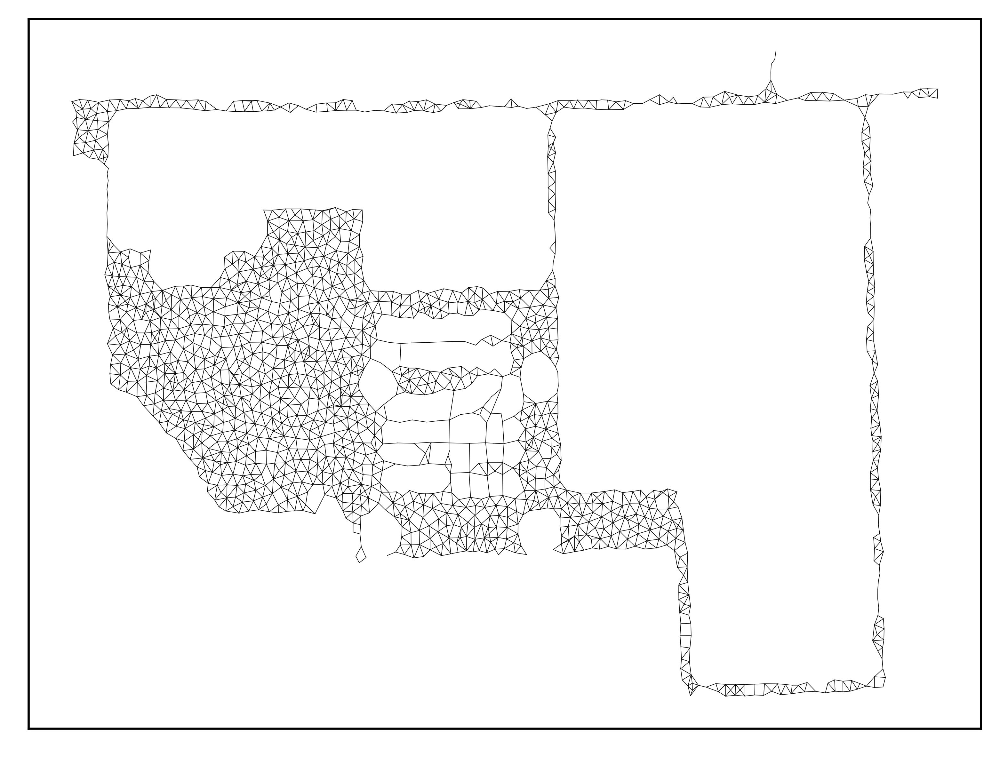

In [89]:
from neupy import algorithms, utils
mpl.rcParams['figure.dpi'] = 600
# utils.reproducible()
max_nodes = 1500
gng = create_gng(max_nodes=max_nodes)

while gng.graph.n_nodes < max_nodes:
    gng.train(data, epochs=1)
    # Plot images after each iteration in order to see training progress
    plt.figure()
    draw_image(gng.graph)



/tmp/ipykernel_34724/1413458043.py:60: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  anim = animation.FuncAnimation(fig, animate, tqdm(np.arange(2000)), interval=30, blit=True)


  0%|          | 0/2000 [00:00<?, ?it/s]

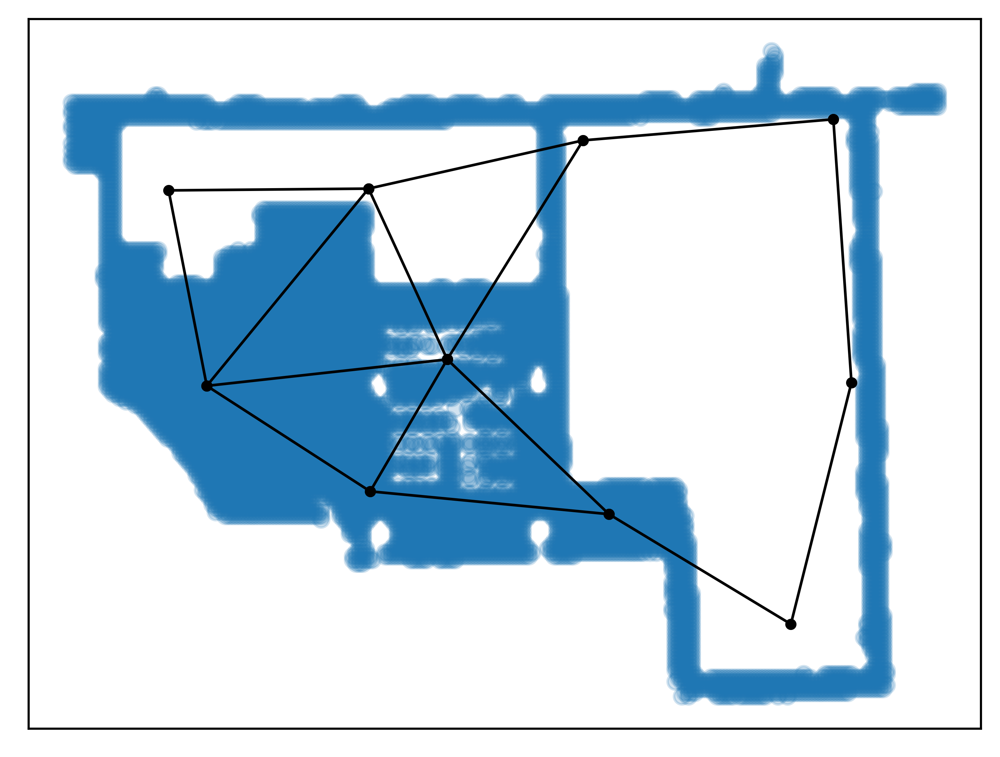

In [101]:
from tqdm import tqdm_notebook as tqdm
# import numpy as np
# import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
# from neupy import algorithms, utils
    
# utils.reproducible()

gng = algorithms.GrowingNeuralGas(
    n_inputs=2,
    n_start_nodes=2,

    shuffle_data=True,
    verbose=False,
    
    step=0.2,
    neighbour_step=0.001,
    
    max_edge_age=50,
    max_nodes=1500,
    
    n_iter_before_neuron_added=100,
    after_split_error_decay_rate=0.5,
    error_decay_rate=0.995,
    min_distance_for_update=0.2,
)

fig = plt.figure()
plt.scatter(*data.T, alpha=0.2)
plt.xticks([], [])
plt.yticks([], [])

def animate(i):
    for line in animate.prev_lines:
        line.remove()
        
    # Training will slow down overtime and we increase number
    # of data samples for training
    n = int(0.5 * gng.n_iter_before_neuron_added * (1 + i // 100))
    
    sampled_data_ids = np.random.choice(len(data), n)
    sampled_data = data[sampled_data_ids, :]
    gng.train(sampled_data, epochs=1)
    
    lines = []
    for node_1, node_2 in gng.graph.edges:
        weights = np.concatenate([node_1.weight, node_2.weight])
        line, = plt.plot(*weights.T, color='black')

        plt.setp(line, linewidth=1, color='black')
        
        lines.append(line)
        lines.append(plt.scatter(*weights.T, color='black', s=10))
    
    animate.prev_lines = lines
    return lines

animate.prev_lines = []
anim = animation.FuncAnimation(fig, animate, tqdm(np.arange(2000)), interval=30, blit=True)
HTML(anim.to_html5_video())